### Load Python libraries

In [1]:
from IPython.display import HTML,display
display(HTML("<style>.container { width:85% !important; }</style>"))

%load_ext autoreload
%autoreload 2

import pandas as pd
import numpy as np
np.corrcoef([0,1], [0,2])
# import bioformats as bf
import os
import islets
from islets.numeric import *
import matplotlib.pyplot as plt
%config InlineBackend.figure_format = 'retina'
from scipy.stats import distributions as dst
# plt.rcParams["animation.embed_limit"] = 200
from copy import deepcopy
from scipy.stats import median_abs_deviation

In [2]:
### Add a path to the pickle you want to investigate (e.g., /data/Marjan/my_pickles_pkl)
from islets.Regions import Regions, load_regions

pathToRois_1 = "/data/Ya-Chi/2024/12152024/Exp4.czi_analysis/all/2025_01_21_5.6_rois.pkl"
pathToRois_1 = pathToRois_1.replace("/local_", "/")
pathToEvents_1 = pathToRois_1.split("_rois")[0]+"_auto_events.csv"
regions_1 = load_regions(pathToRois_1)
regions_1.detrend_traces(method="debleach")

pathToRois_2 = "/local_data/Ya-Chi/2024/12152024/Exp4.czi_analysis/all_c1/2025_01_21_5.6_rois.pkl"
pathToRois_2 = pathToRois_2.replace("/local_", "/")
pathToEvents_2 = pathToRois_2.split("_rois")[0]+"_auto_events.csv"
regions_2 = load_regions(pathToRois_2)
regions_2.detrend_traces(method="debleach")

/opt/conda/lib/python3.10/site-packages/scipy/signal/_arraytools.py:100: RuntimeWarning: overflow encountered in multiply
  ext = np.concatenate((2 * left_end - left_ext,
/opt/conda/lib/python3.10/site-packages/scipy/signal/_arraytools.py:102: RuntimeWarning: overflow encountered in multiply
  2 * right_end - right_ext),
/opt/conda/lib/python3.10/site-packages/islets/Regions.py:1001: RuntimeWarning: Mean of empty slice.
  x = np.array([slow_est[d==i].mean() for i in irange])
/opt/conda/lib/python3.10/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.10/site-packages/islets/Regions.py:1026: RuntimeWarning: Mean of empty slice.
  x = np.array([slow_est[d==i].mean() for i in irange])
/opt/conda/lib/python3.10/site-packages/scipy/signal/_arraytools.py:100: RuntimeWarning: overflow encountered in multiply
  ext = np.concatenate((2 * left_end - left_ext,
/opt/conda/lib/python3.10/s

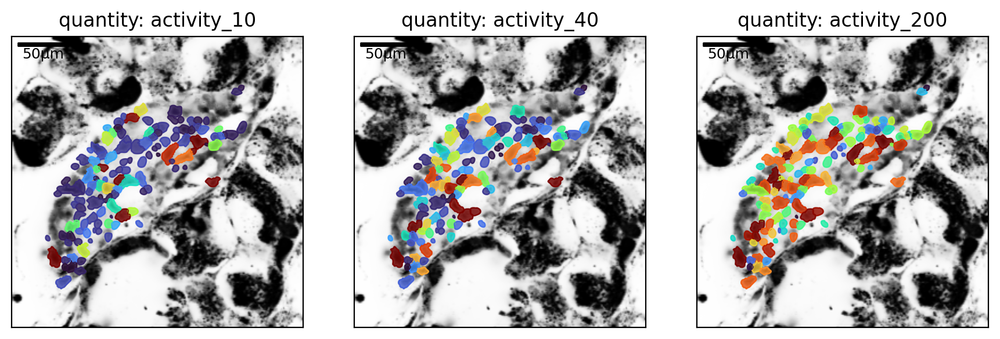

In [3]:
### Check for the activity at different timescales 
timescales = [10,40,200]
fig, axs = plt.subplots(1,len(timescales),figsize=(3*len(timescales),3), sharex=True, sharey=True)
for ts,ax in zip(timescales,axs):
    quantity = "activity_%g"%ts
    regions_2.get_activity(timescale=ts, saveAs=quantity)
    ax.set_title(f"quantity: {quantity}")
    regions_2.color_according_to(quantity)
    regions_2.plotEdges(ax=ax, separate=True,fill=True,)
    ax.set_xticks([])
    ax.set_yticks([])
plt.subplots_adjust(wspace=.03)
plt.tight_layout()

In [4]:
### Select the time domain where you expect most relevant activity (10 means up to 10 s) and the time range in seconds where you expect this activity. The most active cells will be labeled dark red and least active dark blue.
regions_1.get_activity(10,timeframe=(1000,2000),saveAs="activity")
regions_1.color_according_to("activity") # if you prefer colore by activity. you can revert this by deleting "color" column (del regions.df["color"])
regions_2.get_activity(10,timeframe=(1000,2000),saveAs="activity")
regions_2.color_according_to("activity") # if you prefer colore by activity. you can revert this by deleting "color" column (del regions.df["color"])

In [5]:
### Examine the temporal profiles of activity within the ROIs (some platforms have issues with presenting raw data (trace), to solve that change to detrended). 
### If there is an long error message below, you can suppress with clicking on the blue bar on the left

regions_1.examine(fill=False, debug=True) # fill: whether you wish to see rois filled or not


Dash is running on http://127.0.0.1:8055/user/ya-chi/proxy/8055/



In [6]:
regions_2.examine(fill=True, debug=True) # fill: whether you wish to see rois filled or not

Dash is running on http://127.0.0.1:8056/user/ya-chi/proxy/8056/



/opt/conda/lib/python3.10/site-packages/islets/utils.py:556: FutureWarning:

elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison



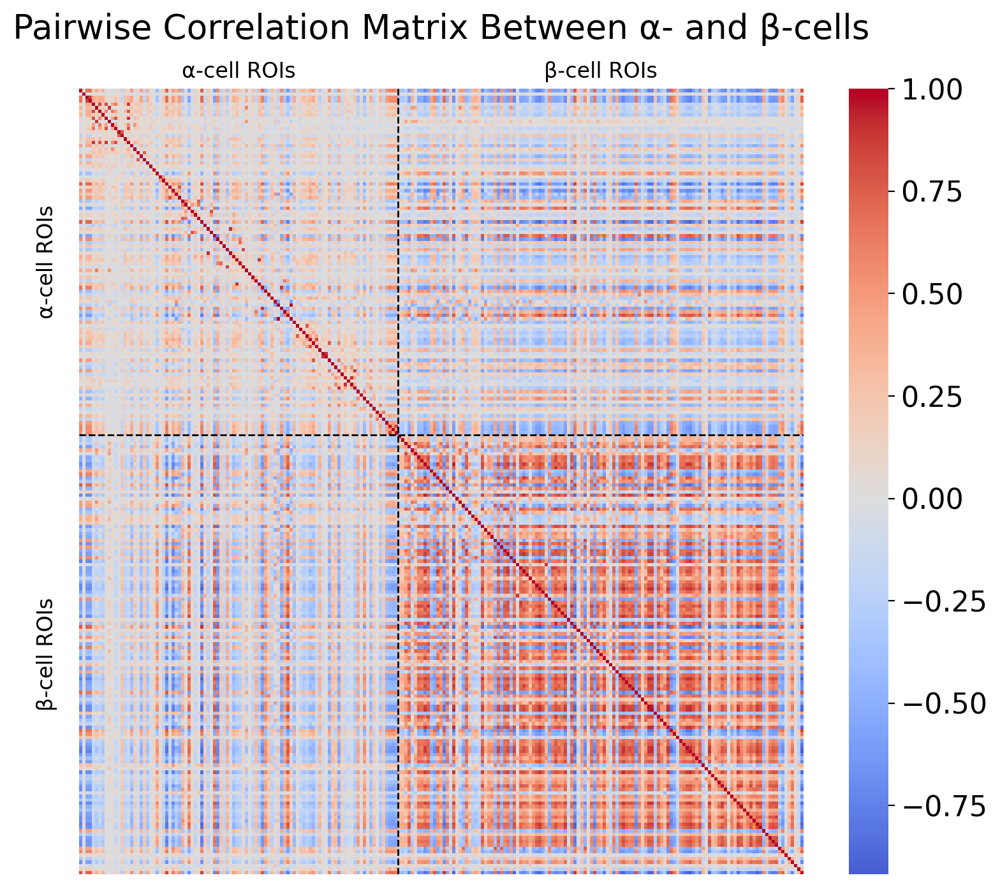

/tmp/ipykernel_134319/2935861619.py:100: UserWarning:

This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.



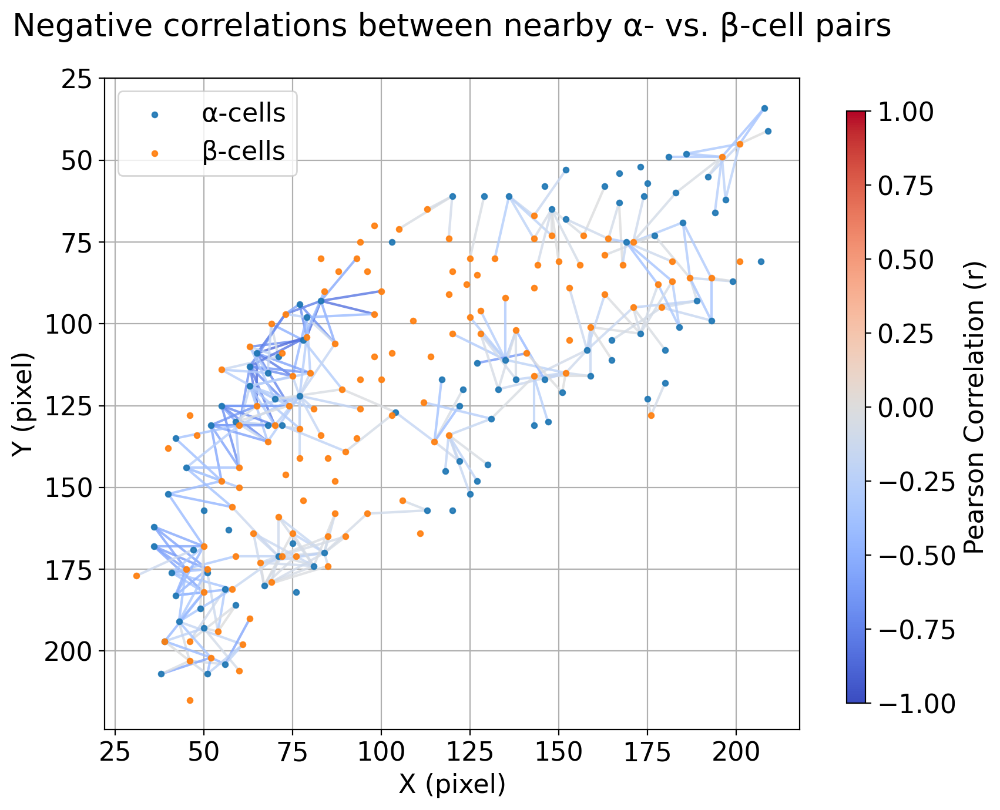

In [12]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
import seaborn as sns
from scipy.stats import pearsonr

# --------------------------
# Parameters
# --------------------------
t_min, t_max = 0, 3600          # Time window
pos_thresh, neg_thresh = 0.5, -0.5
dist_thresh = 20                 # Pixel distance threshold for line plotting (20pixel is about 25um in actual distance)

mpl.rcParams.update({'font.size': 16})

# --------------------------
# Extract time windowed traces
# --------------------------
time_vector = regions_1.time  # Shared time vector
time_mask = (time_vector >= t_min) & (time_vector <= t_max)

traces_1 = np.stack(regions_1.df["detrended"].apply(lambda x: np.array(x)[time_mask]))
traces_2 = np.stack(regions_2.df["detrended"].apply(lambda x: np.array(x)[time_mask]))
n1, n2 = traces_1.shape[0], traces_2.shape[0]

# ROI coordinates (needed for plotting)
coords_1 = np.array([p[::-1] for p in regions_1.df["peak"].values])
coords_2 = np.array([p[::-1] for p in regions_2.df["peak"].values])

# --------------------------
# Compute correlation matrix
# --------------------------
# Option 1: full pairwise correlation using numpy for speed
correlation_matrix = np.corrcoef(np.vstack([traces_1, traces_2]))
# Extract α-β correlations only
alpha_beta_corr = correlation_matrix[:n1, n1:n1+n2]

# Identify pair types
positive_pairs = np.argwhere(alpha_beta_corr > pos_thresh)
neutral_pairs = np.argwhere((alpha_beta_corr >= -0.3) & (alpha_beta_corr <= 0.3))
negative_pairs = np.argwhere(alpha_beta_corr < neg_thresh)

# --------------------------
# Plot correlation heatmap
# --------------------------
fig, ax = plt.subplots(figsize=(8, 7.2))
sns.heatmap(correlation_matrix, cmap='coolwarm', center=0,
            xticklabels=False, yticklabels=False, ax=ax)

# Divider lines between α and β ROIs
ax.axhline(n1, color='black', linestyle='--', linewidth=1)
ax.axvline(n1, color='black', linestyle='--', linewidth=1)

# Labels
ax.text(n1/2, -5, "α-cell ROIs", ha='center', va='center', fontsize=12)
ax.text(n1 + n2/2, -5, "β-cell ROIs", ha='center', va='center', fontsize=12)
ax.text(-10, n1/2, "α-cell ROIs", ha='center', va='center', fontsize=12, rotation=90)
ax.text(-10, n1 + n2/2, "β-cell ROIs", ha='center', va='center', fontsize=12, rotation=90)
ax.set_title("Pairwise Correlation Matrix Between α- and β-cells",  y=1.05)
plt.tight_layout()
plt.show()

# --------------------------
# Plot ROI coordinates & negative correlations
# --------------------------
cmap = plt.cm.coolwarm
norm = mpl.colors.Normalize(vmin=-1, vmax=1)

fig, ax = plt.subplots(figsize=(8, 7.2))

# Plot nodes
ax.scatter(*coords_1.T, color="tab:blue", label="α-cells", alpha=0.9, s=10, zorder=3)
ax.scatter(*coords_2.T, color="tab:orange", label="β-cells", alpha=0.9, s=10, zorder=3)

# Plot negative correlation lines between nearby cells
for i, coord1 in enumerate(coords_1):
    diffs = coords_2 - coord1
    dists = np.linalg.norm(diffs, axis=1)
    mask = (alpha_beta_corr[i] < 0) & (dists < dist_thresh)
    for j in np.where(mask)[0]:
        ax.plot([coord1[0], coords_2[j, 0]],
                [coord1[1], coords_2[j, 1]],
                color=cmap(norm(alpha_beta_corr[i, j])),
                linewidth=1.5, alpha=0.8)

# Formatting
ax.set_title("Negative correlations between nearby α- vs. β-cell pairs", y=1.05)
ax.set_xlabel("X (pixel)")
ax.set_ylabel("Y (pixel)")
ax.invert_yaxis()
ax.grid(True)
ax.legend()

# Colorbar
cbar_ax = fig.add_axes([0.92, 0.15, 0.02, 0.7])
sm = mpl.cm.ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])
fig.colorbar(sm, cax=cbar_ax, label="Pearson Correlation (r)")

plt.tight_layout(rect=[0, 0, 0.9, 1])
plt.show()


In [8]:
import numpy as np
import pandas as pd
from scipy.stats import pearsonr
import matplotlib.pyplot as plt
import seaborn as sns

# Define time window
t_min = 0
t_max = 3600

# Get time vector (shared by both)
time_vector = regions_1.time  # or regions_2.time

# Find frame indices within time window
time_mask = (time_vector >= t_min) & (time_vector <= t_max)

# Extract and slice traces
traces_1 = np.stack(regions_1.df["detrended"].apply(lambda x: np.array(x)[time_mask]))
traces_2 = np.stack(regions_2.df["detrended"].apply(lambda x: np.array(x)[time_mask]))
n1, n2 = traces_1.shape[0], traces_2.shape[0]

# Initialize correlation matrix
correlation_matrix = np.zeros((n1, n2))

# Pairwise correlation
for i in range(n1):
    for j in range(n2):
        r, _ = pearsonr(traces_1[i], traces_2[j])
        correlation_matrix[i, j] = r

In [9]:
# Define correlation thresholds
pos_thresh = 0.5
neg_thresh = -0.5

# Identify pair types
positive_pairs = np.argwhere(correlation_matrix > pos_thresh)
neutral_pairs = np.argwhere((correlation_matrix >= -0.3) & (correlation_matrix <= 0.3))
negative_pairs = np.argwhere(correlation_matrix < neg_thresh)

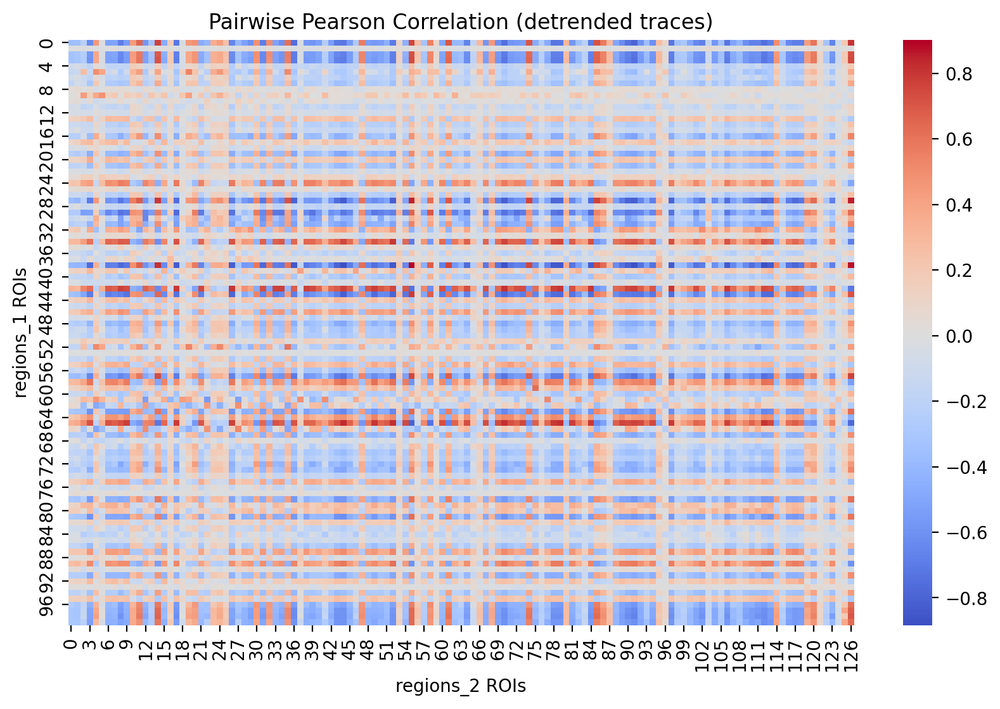

In [10]:
plt.figure(figsize=(10, 6))
sns.heatmap(correlation_matrix, cmap="coolwarm", center=0)
plt.xlabel("regions_2 ROIs")
plt.ylabel("regions_1 ROIs")
plt.title("Pairwise Pearson Correlation (detrended traces)")
plt.show()

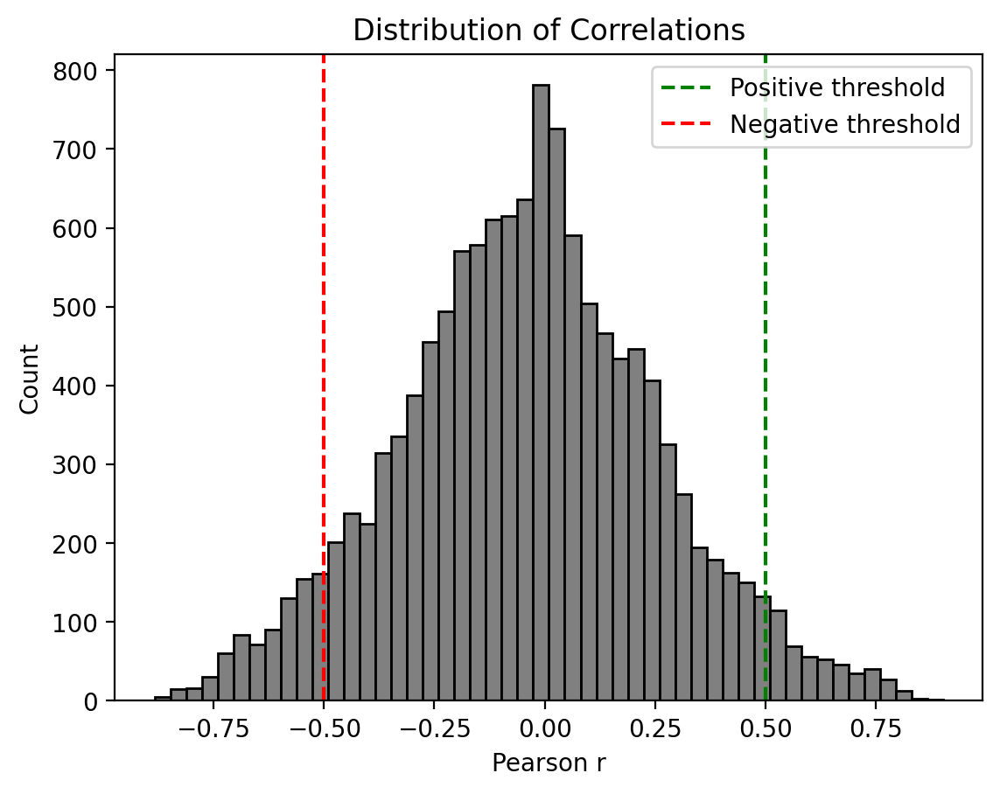

In [11]:
plt.figure()
plt.hist(correlation_matrix.flatten(), bins=50, color='gray', edgecolor='black')
plt.axvline(0.5, color='green', linestyle='--', label='Positive threshold')
plt.axvline(-0.5, color='red', linestyle='--', label='Negative threshold')
plt.legend()
plt.title("Distribution of Correlations")
plt.xlabel("Pearson r")
plt.ylabel("Count")
plt.show()

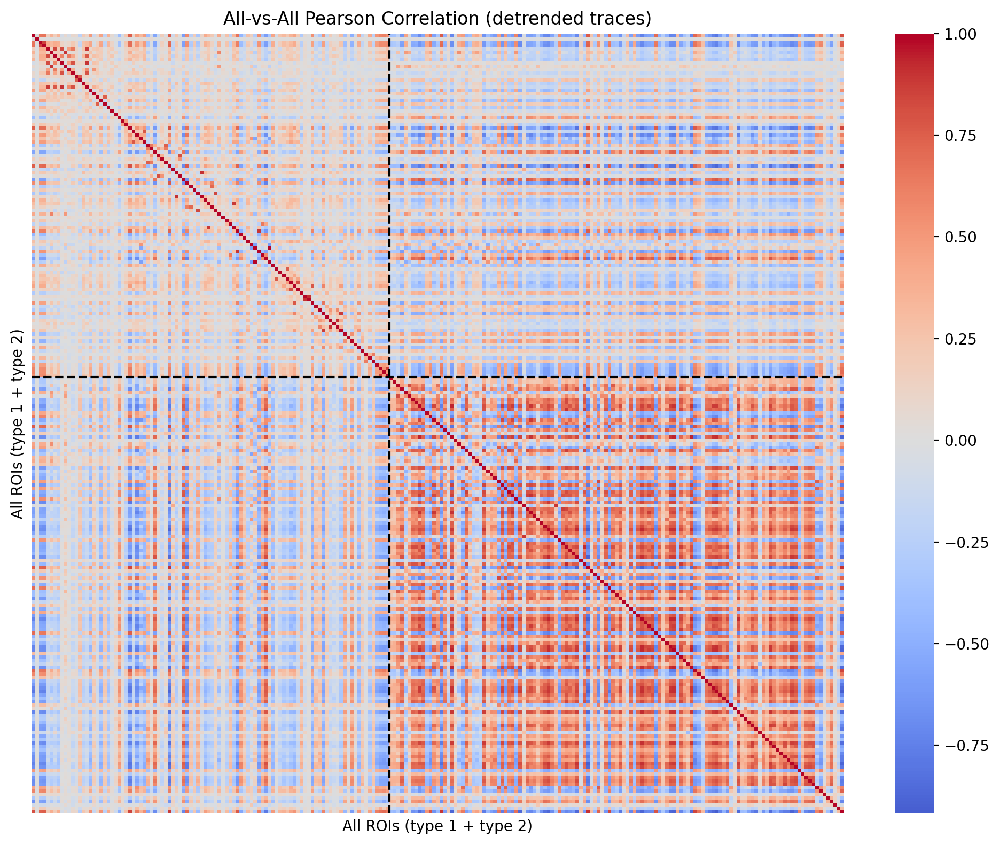

In [12]:
import numpy as np
import pandas as pd
from scipy.stats import pearsonr
import seaborn as sns
import matplotlib.pyplot as plt

# Step 1: Extract traces
#traces_1 = np.stack(regions_1.df["detrended"].values)
#traces_2 = np.stack(regions_2.df["detrended"].values)

# Step 2: Concatenate
all_traces = np.vstack([traces_1, traces_2])  # shape (n_total, t)

# Step 3: Compute correlation matrix
n = all_traces.shape[0]
correlation_matrix = np.corrcoef(all_traces)  # fast and vectorized

# Step 4: Plot
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, cmap="coolwarm", center=0,
            xticklabels=False, yticklabels=False)
plt.title("All-vs-All Pearson Correlation (detrended traces)")
plt.xlabel("All ROIs (type 1 + type 2)")
plt.ylabel("All ROIs (type 1 + type 2)")


boundary = traces_1.shape[0]
plt.axhline(boundary, color='black', linestyle='--')
plt.axvline(boundary, color='black', linestyle='--')


plt.tight_layout()
plt.show()


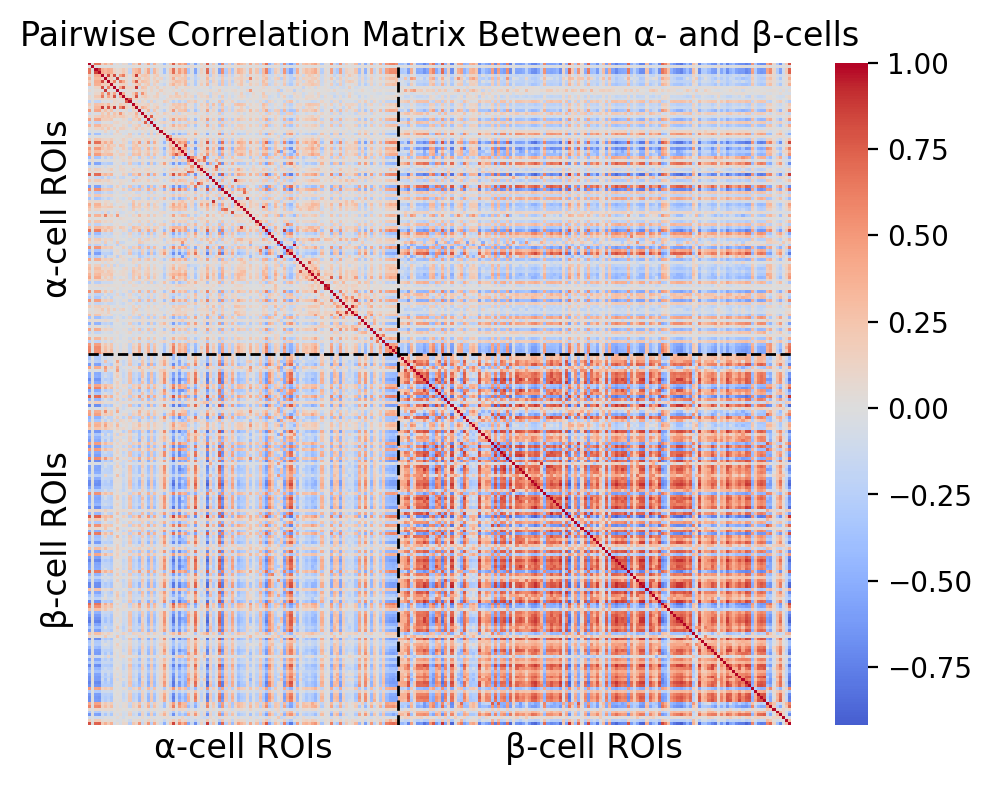

In [13]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# Example setup
n1 = traces_1.shape[0]
n2 = traces_2.shape[0]
correlation_matrix = np.corrcoef(np.vstack([traces_1, traces_2]))

fig, ax = plt.subplots(figsize=(5, 4))

# Plot heatmap
sns.heatmap(correlation_matrix, cmap='coolwarm', center=0,
            xticklabels=False, yticklabels=False, ax=ax)

# Divider lines
ax.axhline(n1, color='black', linestyle='--', linewidth=1)
ax.axvline(n1, color='black', linestyle='--', linewidth=1)

# Label the sections on the x-axis
ax.text(n1 / 2, 235, "α-cell ROIs", ha='center', va='center', fontsize=12)
ax.text(n1 + n2 / 2, 235, "β-cell ROIs", ha='center', va='center', fontsize=12)

# Label the sections on the y-axis (rotated)
ax.text(-10, n1 / 2, "α-cell ROIs", ha='center', va='center', fontsize=12, rotation=90)
ax.text(-10, n1 + n2 / 2, "β-cell ROIs", ha='center', va='center', fontsize=12, rotation=90)

# Axis titles
ax.set_title("Pairwise Correlation Matrix Between α- and β-cells")
#ax.set_xlabel("ROI Index")
#ax.set_ylabel("ROI Index")

plt.tight_layout()
plt.show()


In [14]:
!pip install umap-learn

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 89.2/89.2 kB 3.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.9/12.9 MB 24.1 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.9/56.9 kB 9.3 MB/s eta 0:00:00
  Attempting uninstall: scikit-learn
    Found existing installation: scikit-learn 1.2.2
    Uninstalling scikit-learn-1.2.2:
      Successfully uninstalled scikit-learn-1.2.2

[notice] A new release of pip is available: 23.1 -> 25.1.1
[notice] To update, run: pip install --upgrade pip


/opt/conda/lib/python3.10/site-packages/umap/umap_.py:1865: UserWarning:

using precomputed metric; inverse_transform will be unavailable

/opt/conda/lib/python3.10/site-packages/umap/umap_.py:1952: UserWarning:

n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.



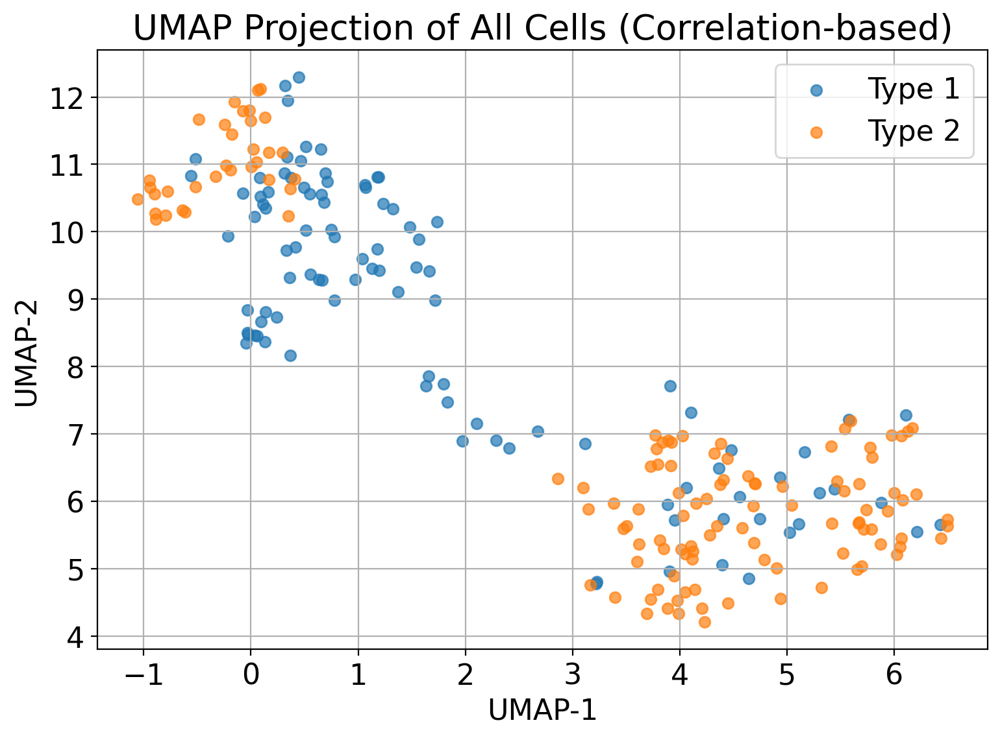

In [18]:
import umap
import numpy as np
import matplotlib.pyplot as plt

# Assume you already have `correlation_matrix` from earlier
# Step 1: Convert correlation matrix to a distance matrix
# Use (1 - r) as a distance measure (bounded 0 to 2)
distance_matrix = 1 - correlation_matrix

# Step 2: Run UMAP
reducer = umap.UMAP(metric="precomputed", random_state=42)
embedding = reducer.fit_transform(distance_matrix)  # shape (n_cells, 2)

# Step 3: Plot
n1 = traces_1.shape[0]  # number of cells in regions_1
n2 = traces_2.shape[0]  # number of cells in regions_2

plt.figure(figsize=(8, 6))
plt.scatter(embedding[:n1, 0], embedding[:n1, 1], label='Type 1', c='tab:blue', alpha=0.7)
plt.scatter(embedding[n1:, 0], embedding[n1:, 1], label='Type 2', c='tab:orange', alpha=0.7)
plt.title("UMAP Projection of All Cells (Correlation-based)")
plt.xlabel("UMAP-1")
plt.ylabel("UMAP-2")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


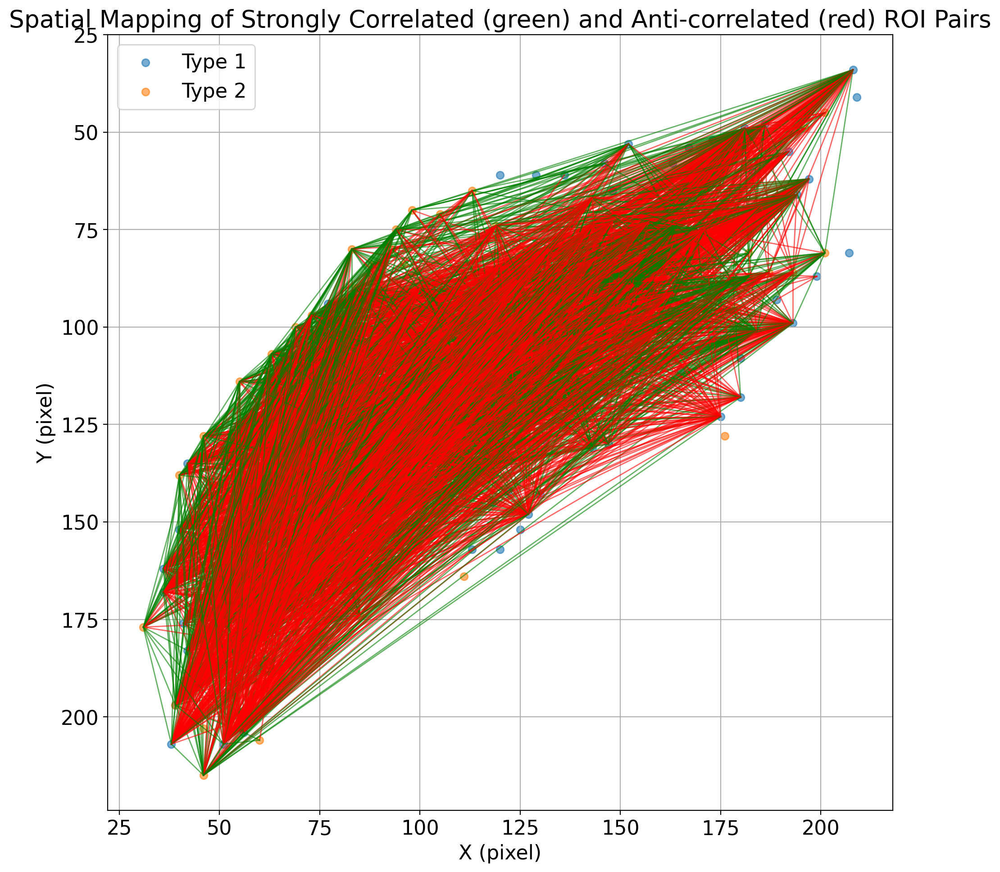

In [19]:
# Thresholds
pos_thresh = 0.3
neg_thresh = -0.3

# Separate correlation blocks
n1 = traces_1.shape[0]
n2 = traces_2.shape[0]

# ROI coordinates
coords_1 = np.array([p[::-1] for p in regions_1.df["peak"].values])  # (x, y)
coords_2 = np.array([p[::-1] for p in regions_2.df["peak"].values])  # (x, y)

# Plot
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 10))
plt.scatter(*coords_1.T, color="tab:blue", label="Type 1", alpha=0.6)
plt.scatter(*coords_2.T, color="tab:orange", label="Type 2", alpha=0.6)

# Loop through all cross-type pairs
for i in range(n1):
    for j in range(n2):
        r = correlation_matrix[i, n1 + j]  # full correlation matrix indexing
        if r > pos_thresh:
            plt.plot([coords_1[i, 0], coords_2[j, 0]], [coords_1[i, 1], coords_2[j, 1]],
                     color="green", linewidth=1, alpha=0.6)
        elif r < neg_thresh:
            plt.plot([coords_1[i, 0], coords_2[j, 0]], [coords_1[i, 1], coords_2[j, 1]],
                     color="red", linewidth=1, alpha=0.6)

plt.title("Spatial Mapping of Strongly Correlated (green) and Anti-correlated (red) ROI Pairs")
plt.xlabel("X (pixel)")
plt.ylabel("Y (pixel)")
plt.legend()
plt.gca().invert_yaxis()  # match image coordinates if needed
plt.grid(True)
plt.tight_layout()
plt.show()


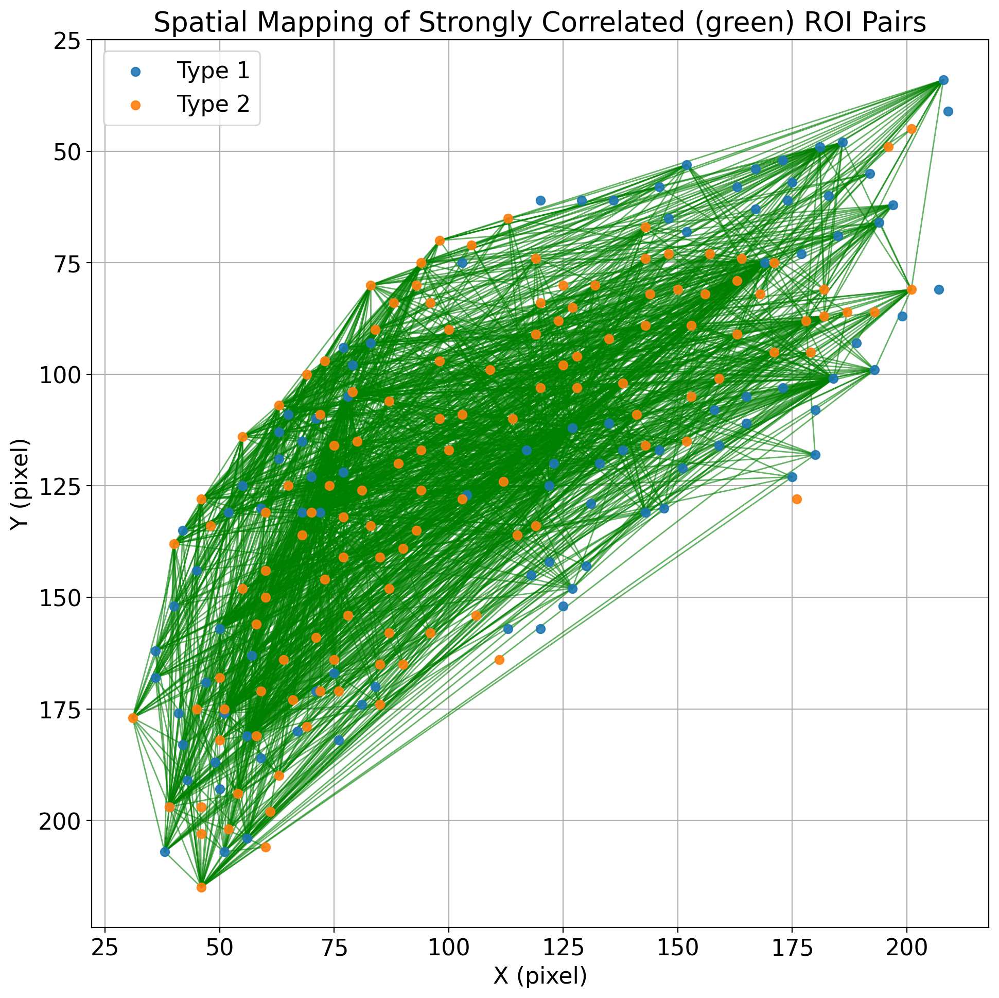

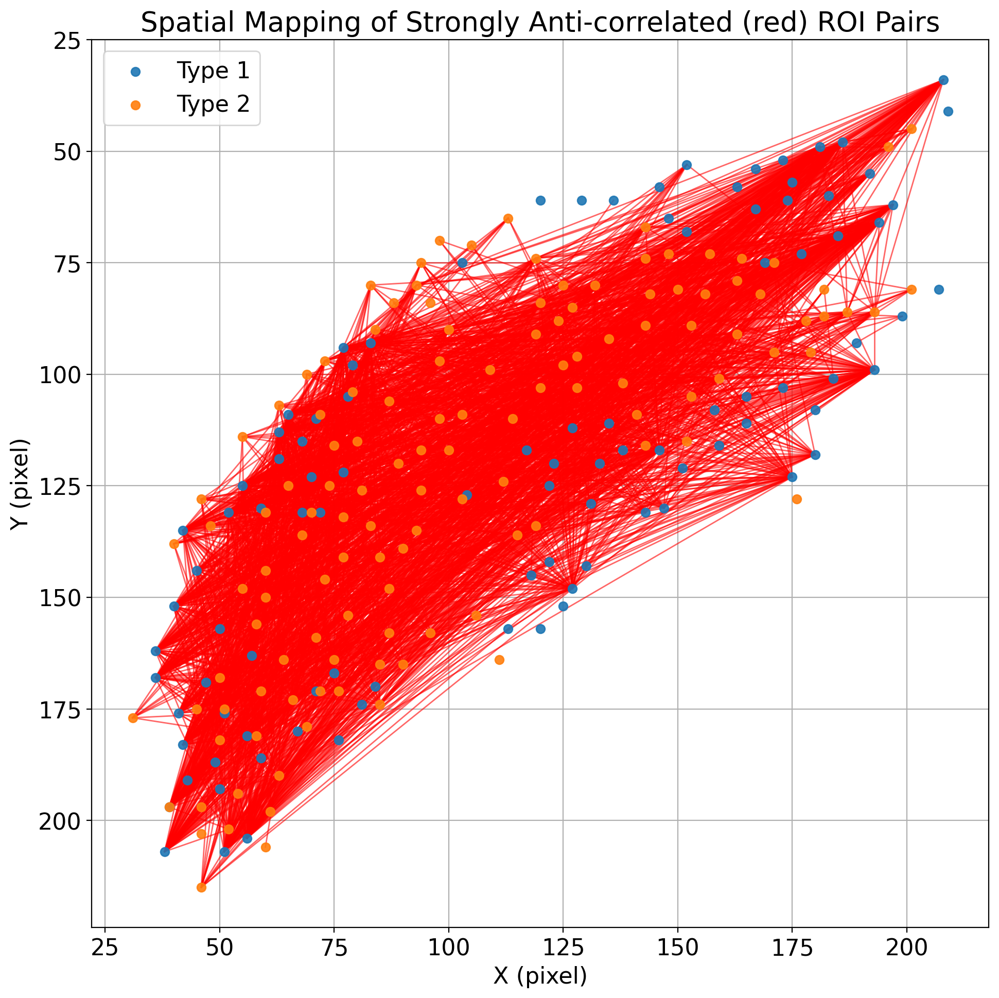

In [20]:
import matplotlib.pyplot as plt

# Plot 1: Strong Positive Correlations with nodes on top
plt.figure(figsize=(10, 10))

# First draw all the green lines
for i in range(n1):
    for j in range(n2):
        r = correlation_matrix[i, n1 + j]
        if r > pos_thresh:
            plt.plot([coords_1[i, 0], coords_2[j, 0]],
                     [coords_1[i, 1], coords_2[j, 1]],
                     color="green", linewidth=1, alpha=0.6)

# Then plot the scatter points on top
plt.scatter(*coords_1.T, color="tab:blue", label="Type 1", alpha=0.9, zorder=5)
plt.scatter(*coords_2.T, color="tab:orange", label="Type 2", alpha=0.9, zorder=5)

plt.title("Spatial Mapping of Strongly Correlated (green) ROI Pairs")
plt.xlabel("X (pixel)")
plt.ylabel("Y (pixel)")
plt.legend()
plt.gca().invert_yaxis()
plt.grid(True)
plt.tight_layout()
plt.show()


# Plot 2: Strong Negative Correlations with nodes on top
plt.figure(figsize=(10, 10))

# Draw red lines first
for i in range(n1):
    for j in range(n2):
        r = correlation_matrix[i, n1 + j]
        if r < neg_thresh:
            plt.plot([coords_1[i, 0], coords_2[j, 0]],
                     [coords_1[i, 1], coords_2[j, 1]],
                     color="red", linewidth=1, alpha=0.6)

# Plot scatter points on top
plt.scatter(*coords_1.T, color="tab:blue", label="Type 1", alpha=0.9, zorder=5)
plt.scatter(*coords_2.T, color="tab:orange", label="Type 2", alpha=0.9, zorder=5)

plt.title("Spatial Mapping of Strongly Anti-correlated (red) ROI Pairs")
plt.xlabel("X (pixel)")
plt.ylabel("Y (pixel)")
plt.legend()
plt.gca().invert_yaxis()
plt.grid(True)
plt.tight_layout()
plt.show()


/tmp/ipykernel_79948/867771546.py:34: MatplotlibDeprecationWarning:

Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.



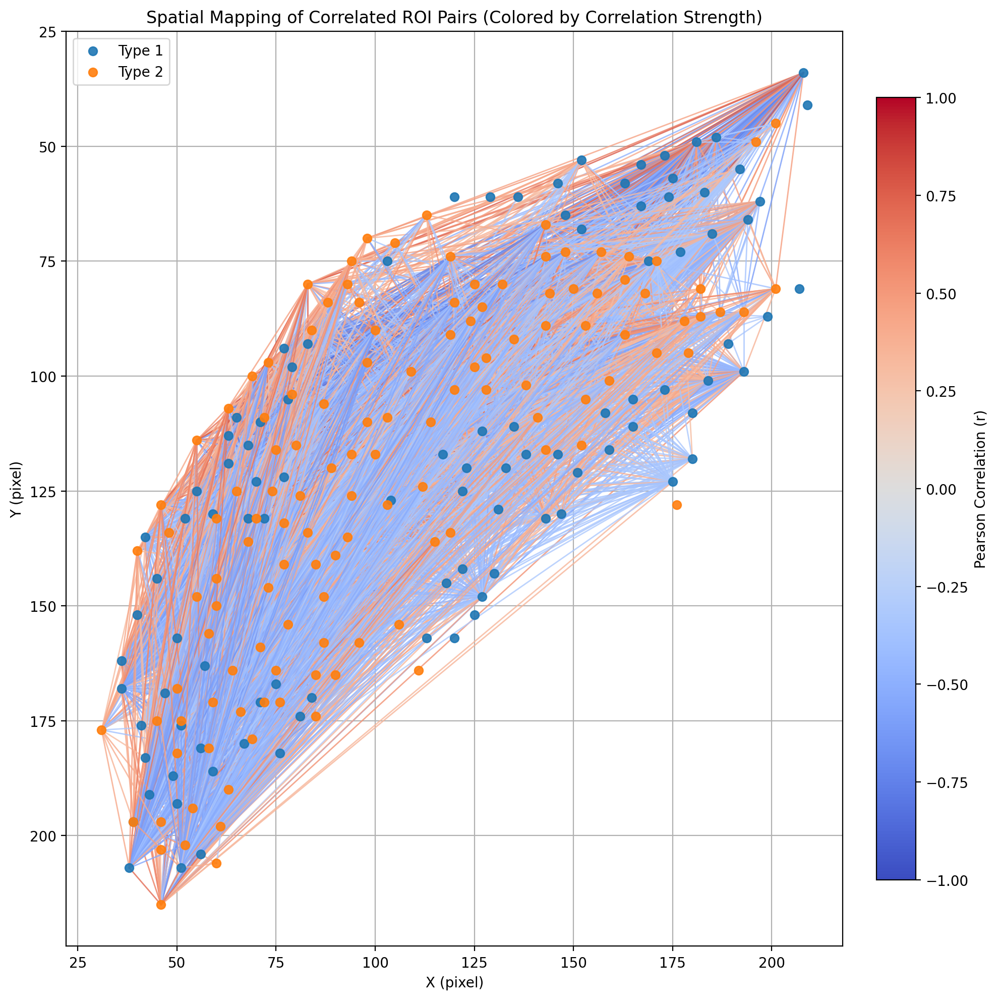

In [17]:
import matplotlib.pyplot as plt
import matplotlib as mpl
import numpy as np

plt.figure(figsize=(10, 10))

# Create colormap and normalization
cmap = plt.cm.coolwarm
norm = mpl.colors.Normalize(vmin=-1, vmax=1)  # Pearson r ranges from -1 to 1

for i in range(n1):
    for j in range(n2):
        r = correlation_matrix[i, n1 + j]
        if abs(r) > 0.3:  # Only plot strong correlations (positive or negative)
            color = cmap(norm(r))
            plt.plot([coords_1[i, 0], coords_2[j, 0]],
                     [coords_1[i, 1], coords_2[j, 1]],
                     color=color, linewidth=1, alpha=0.8)

# Plot nodes on top
plt.scatter(*coords_1.T, color="tab:blue", label="Type 1", alpha=0.9, zorder=5)
plt.scatter(*coords_2.T, color="tab:orange", label="Type 2", alpha=0.9, zorder=5)

plt.title("Spatial Mapping of Correlated ROI Pairs (Colored by Correlation Strength)")
plt.xlabel("X (pixel)")
plt.ylabel("Y (pixel)")
plt.legend()
plt.gca().invert_yaxis()
plt.grid(True)

# Add colorbar
sm = mpl.cm.ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])
cbar = plt.colorbar(sm, fraction=0.046, pad=0.04)
cbar.set_label("Pearson Correlation (r)")

plt.tight_layout()
plt.show()


/tmp/ipykernel_351/1524495885.py:32: MatplotlibDeprecationWarning:

Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.



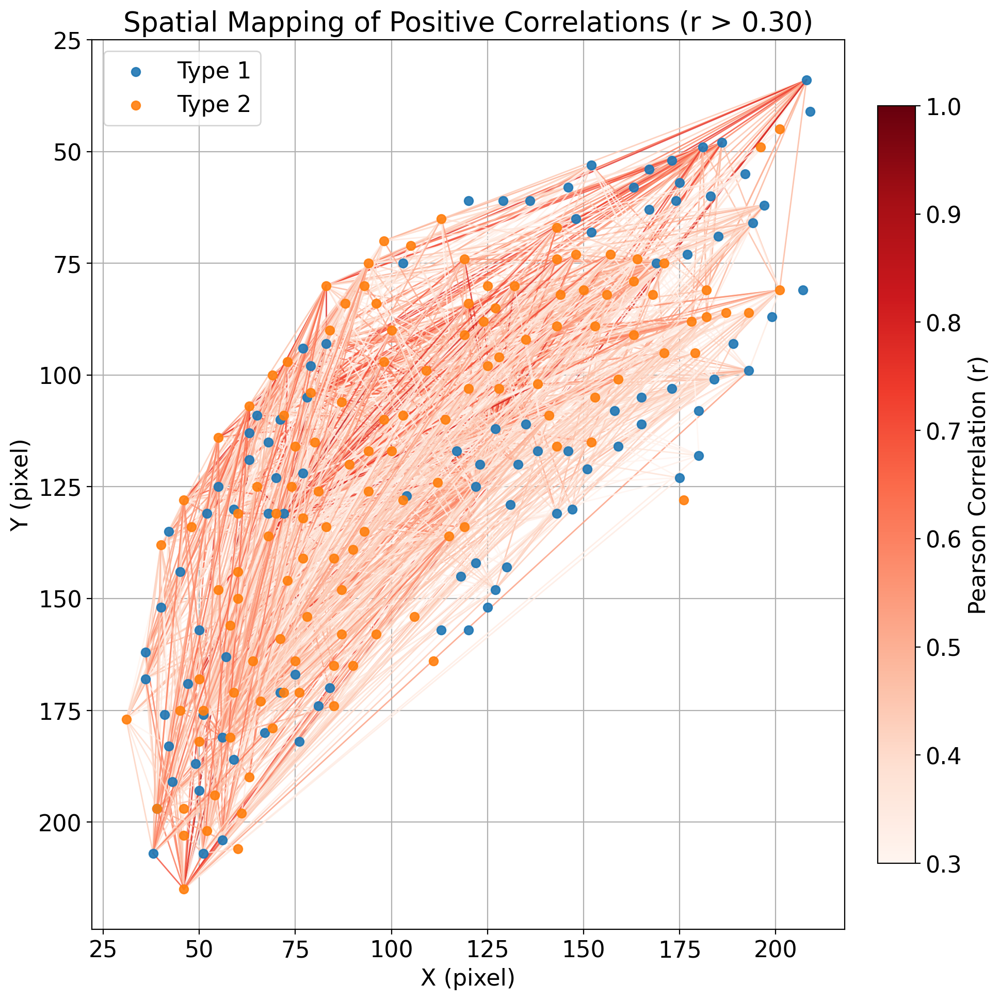

/tmp/ipykernel_351/1524495885.py:66: MatplotlibDeprecationWarning:

Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.



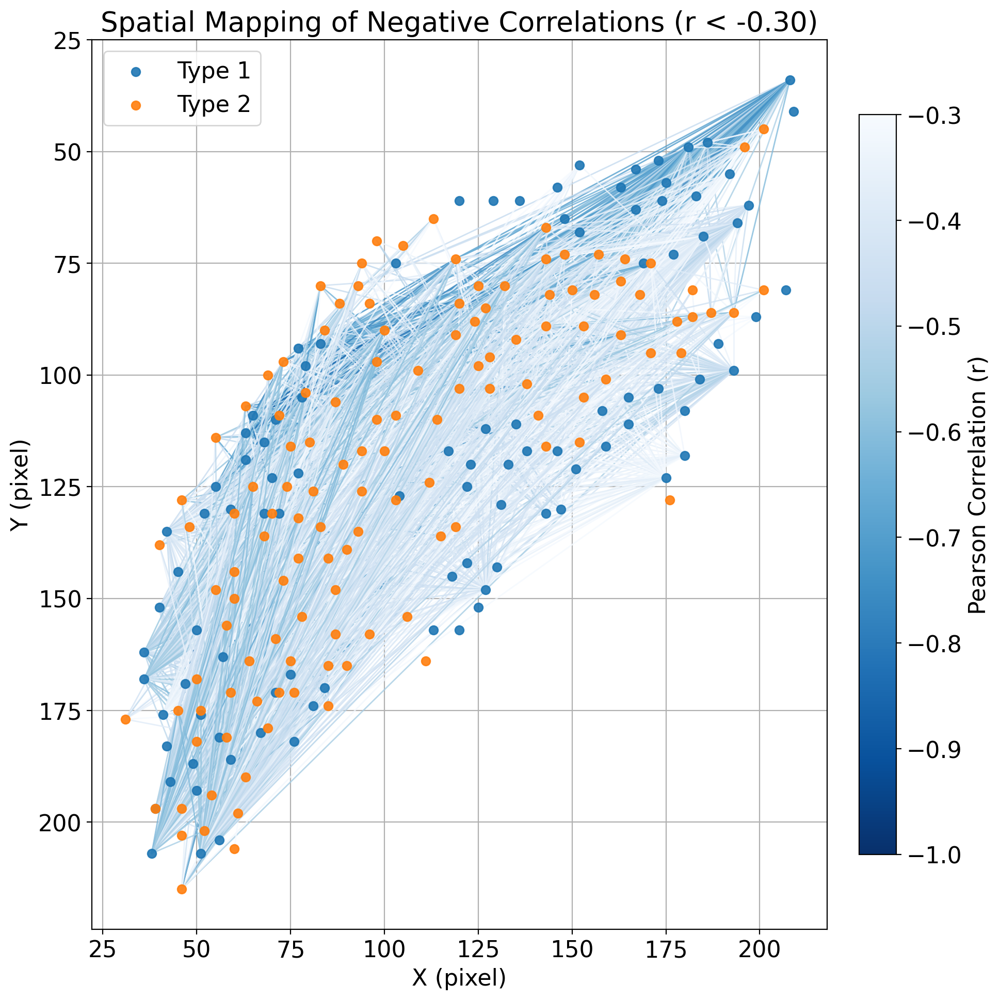

In [21]:
import matplotlib.pyplot as plt
import matplotlib as mpl
import numpy as np

# Positive correlations plot
plt.figure(figsize=(10, 10))

pos_cmap = plt.cm.Reds  # Reds colormap for positive
pos_norm = mpl.colors.Normalize(vmin=pos_thresh, vmax=1)

for i in range(n1):
    for j in range(n2):
        r = correlation_matrix[i, n1 + j]
        if r > pos_thresh:
            color = pos_cmap(pos_norm(r))
            plt.plot([coords_1[i, 0], coords_2[j, 0]],
                     [coords_1[i, 1], coords_2[j, 1]],
                     color=color, linewidth=1, alpha=0.8)

plt.scatter(*coords_1.T, color="tab:blue", label="Type 1", alpha=0.9, zorder=5)
plt.scatter(*coords_2.T, color="tab:orange", label="Type 2", alpha=0.9, zorder=5)

plt.title("Spatial Mapping of Positive Correlations (r > {:.2f})".format(pos_thresh))
plt.xlabel("X (pixel)")
plt.ylabel("Y (pixel)")
plt.legend()
plt.gca().invert_yaxis()
plt.grid(True)

sm_pos = mpl.cm.ScalarMappable(cmap=pos_cmap, norm=pos_norm)
sm_pos.set_array([])
cbar_pos = plt.colorbar(sm_pos, fraction=0.046, pad=0.04)
cbar_pos.set_label("Pearson Correlation (r)")

plt.tight_layout()
plt.show()


# Negative correlations plot
plt.figure(figsize=(10, 10))

neg_cmap = plt.cm.Blues_r  # Blues reversed colormap for negative correlations
neg_norm = mpl.colors.Normalize(vmin=-1, vmax=neg_thresh)

for i in range(n1):
    for j in range(n2):
        r = correlation_matrix[i, n1 + j]
        if r < neg_thresh:
            color = neg_cmap(neg_norm(r))
            plt.plot([coords_1[i, 0], coords_2[j, 0]],
                     [coords_1[i, 1], coords_2[j, 1]],
                     color=color, linewidth=1, alpha=0.8)

plt.scatter(*coords_1.T, color="tab:blue", label="Type 1", alpha=0.9, zorder=5)
plt.scatter(*coords_2.T, color="tab:orange", label="Type 2", alpha=0.9, zorder=5)

plt.title("Spatial Mapping of Negative Correlations (r < {:.2f})".format(neg_thresh))
plt.xlabel("X (pixel)")
plt.ylabel("Y (pixel)")
plt.legend()
plt.gca().invert_yaxis()
plt.grid(True)

sm_neg = mpl.cm.ScalarMappable(cmap=neg_cmap, norm=neg_norm)
sm_neg.set_array([])
cbar_neg = plt.colorbar(sm_neg, fraction=0.046, pad=0.04)
cbar_neg.set_label("Pearson Correlation (r)")

plt.tight_layout()
plt.show()


In [22]:
# Correlation matrix for Type 1 nodes only
corr_type1 = correlation_matrix[:n1, :n1]

# Correlation matrix for Type 2 nodes only
corr_type2 = correlation_matrix[n1:, n1:]


/tmp/ipykernel_351/2820027950.py:29: MatplotlibDeprecationWarning:

Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.



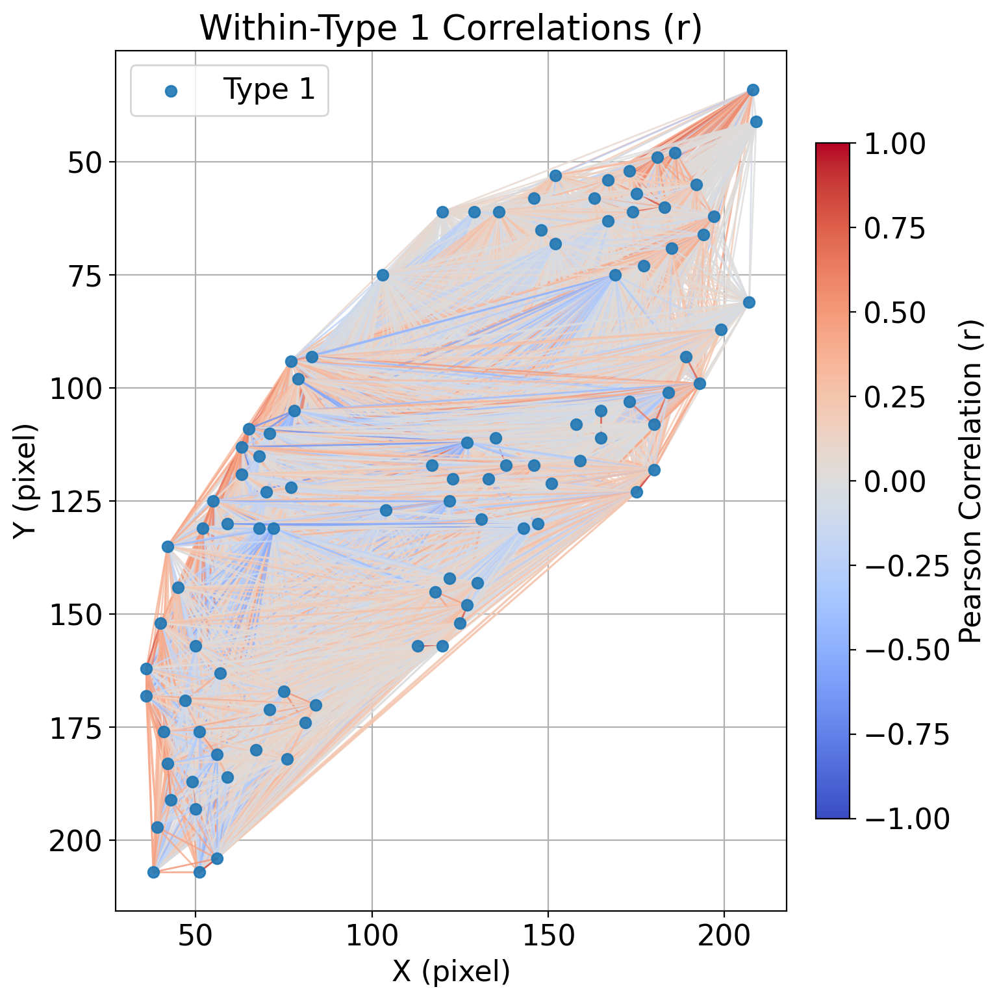

/tmp/ipykernel_351/2820027950.py:57: MatplotlibDeprecationWarning:

Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.



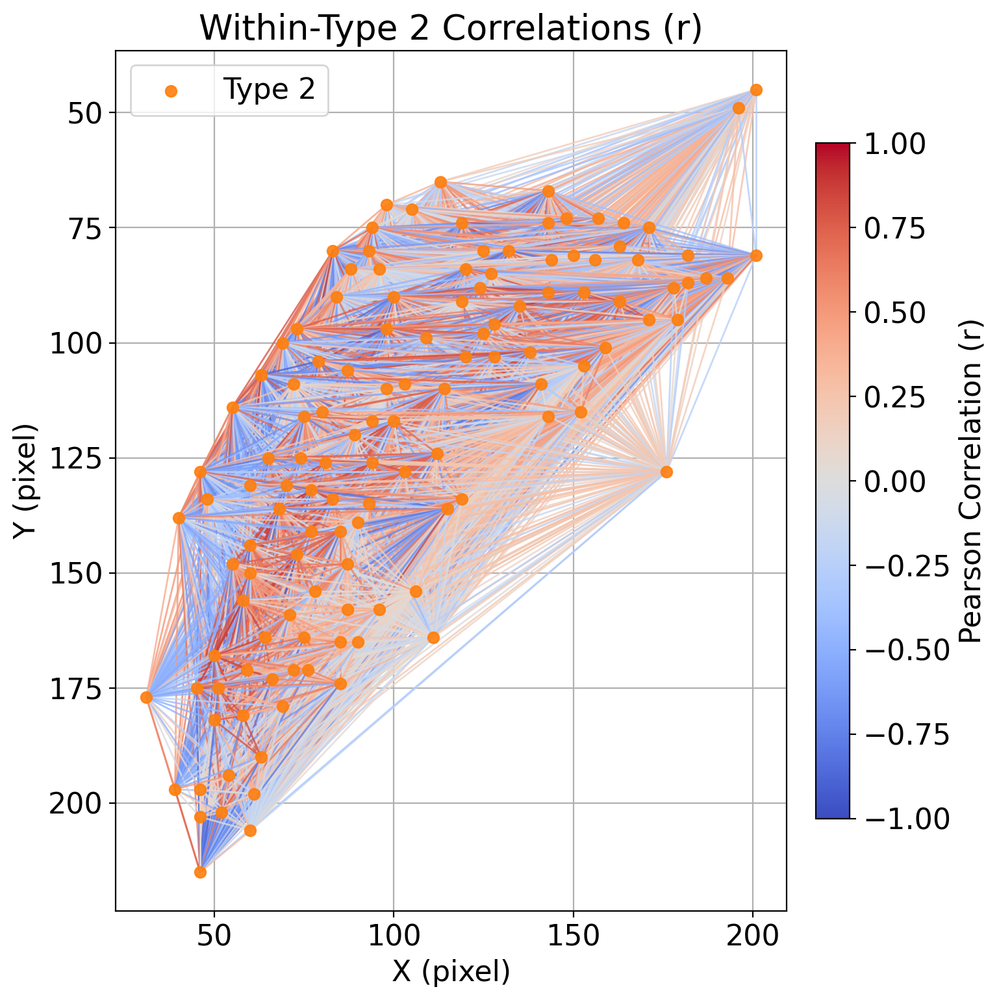

In [23]:
import matplotlib.pyplot as plt
import matplotlib as mpl
import numpy as np

cmap = plt.cm.coolwarm
norm = mpl.colors.Normalize(vmin=-1, vmax=1)

# Plot 1: Type 1 nodes and their mutual correlations
plt.figure(figsize=(8, 8))
for i in range(n1):
    for j in range(i+1, n1):  # only upper triangle to avoid duplicates and self-connections
        r = corr_type1[i, j]
        color = cmap(norm(r))
        plt.plot([coords_1[i, 0], coords_1[j, 0]],
                 [coords_1[i, 1], coords_1[j, 1]],
                 color=color, linewidth=1, alpha=0.8)

plt.scatter(*coords_1.T, color="tab:blue", label="Type 1", alpha=0.9, zorder=5)

plt.title("Within-Type 1 Correlations (r)")
plt.xlabel("X (pixel)")
plt.ylabel("Y (pixel)")
plt.legend()
plt.gca().invert_yaxis()
plt.grid(True)

sm = mpl.cm.ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])
cbar = plt.colorbar(sm, fraction=0.046, pad=0.04)
cbar.set_label("Pearson Correlation (r)")

plt.tight_layout()
plt.show()


# Plot 2: Type 2 nodes and their mutual correlations
plt.figure(figsize=(8, 8))
for i in range(n2):
    for j in range(i+1, n2):
        r = corr_type2[i, j]
        color = cmap(norm(r))
        plt.plot([coords_2[i, 0], coords_2[j, 0]],
                 [coords_2[i, 1], coords_2[j, 1]],
                 color=color, linewidth=1, alpha=0.8)

plt.scatter(*coords_2.T, color="tab:orange", label="Type 2", alpha=0.9, zorder=5)

plt.title("Within-Type 2 Correlations (r)")
plt.xlabel("X (pixel)")
plt.ylabel("Y (pixel)")
plt.legend()
plt.gca().invert_yaxis()
plt.grid(True)

sm = mpl.cm.ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])
cbar = plt.colorbar(sm, fraction=0.046, pad=0.04)
cbar.set_label("Pearson Correlation (r)")

plt.tight_layout()
plt.show()


/tmp/ipykernel_351/3976738038.py:30: MatplotlibDeprecationWarning:

Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.



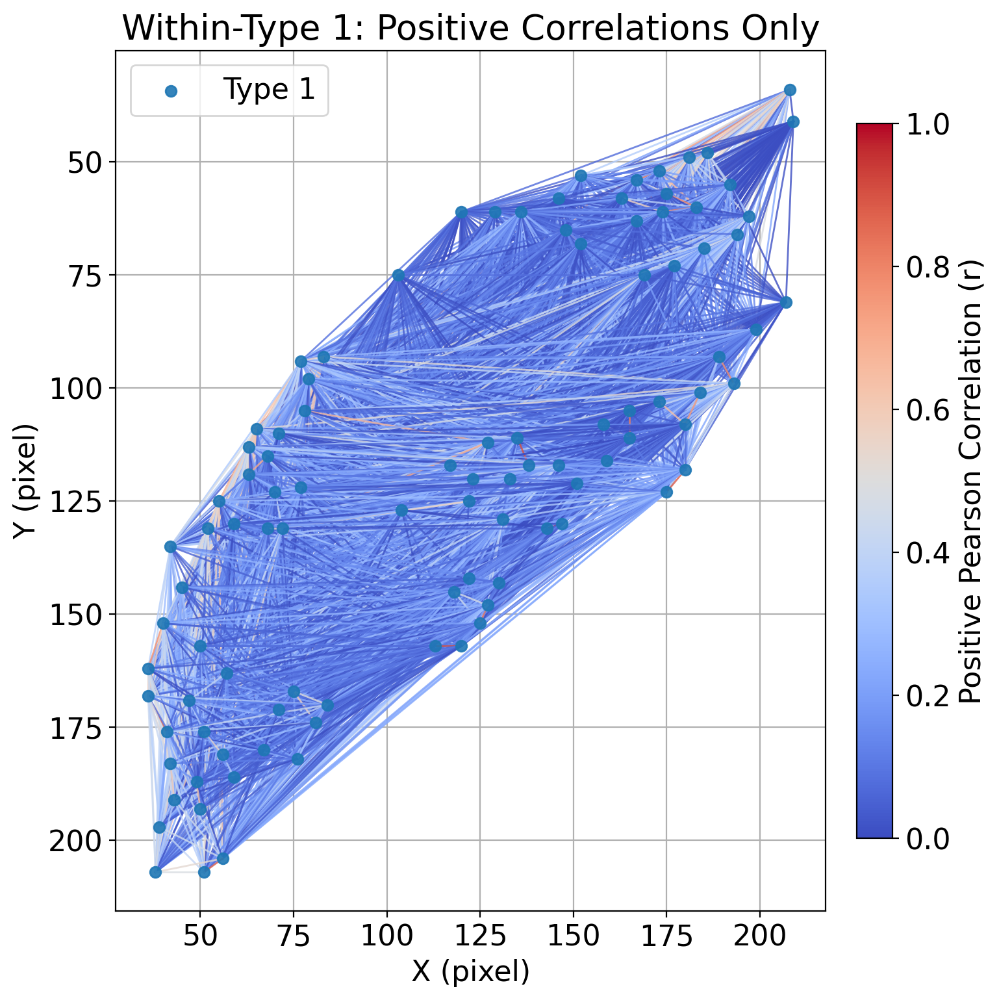

In [24]:
import matplotlib.pyplot as plt
import matplotlib as mpl
import numpy as np

# Setup colormap
cmap = plt.cm.coolwarm
norm = mpl.colors.Normalize(vmin=0, vmax=1)  # only positive range

# Plot 1: Positive correlations among Type 1 nodes
plt.figure(figsize=(8, 8))
for i in range(n1):
    for j in range(i + 1, n1):
        r = corr_type1[i, j]
        if r > 0:
            color = cmap(norm(r))
            plt.plot([coords_1[i, 0], coords_1[j, 0]],
                     [coords_1[i, 1], coords_1[j, 1]],
                     color=color, linewidth=1, alpha=0.8)

plt.scatter(*coords_1.T, color="tab:blue", label="Type 1", alpha=0.9, zorder=5)
plt.title("Within-Type 1: Positive Correlations Only")
plt.xlabel("X (pixel)")
plt.ylabel("Y (pixel)")
plt.legend()
plt.gca().invert_yaxis()
plt.grid(True)

sm = mpl.cm.ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])
cbar = plt.colorbar(sm, fraction=0.046, pad=0.04)
cbar.set_label("Positive Pearson Correlation (r)")

plt.tight_layout()
plt.show()


/tmp/ipykernel_79948/363040572.py:29: MatplotlibDeprecationWarning:

Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.



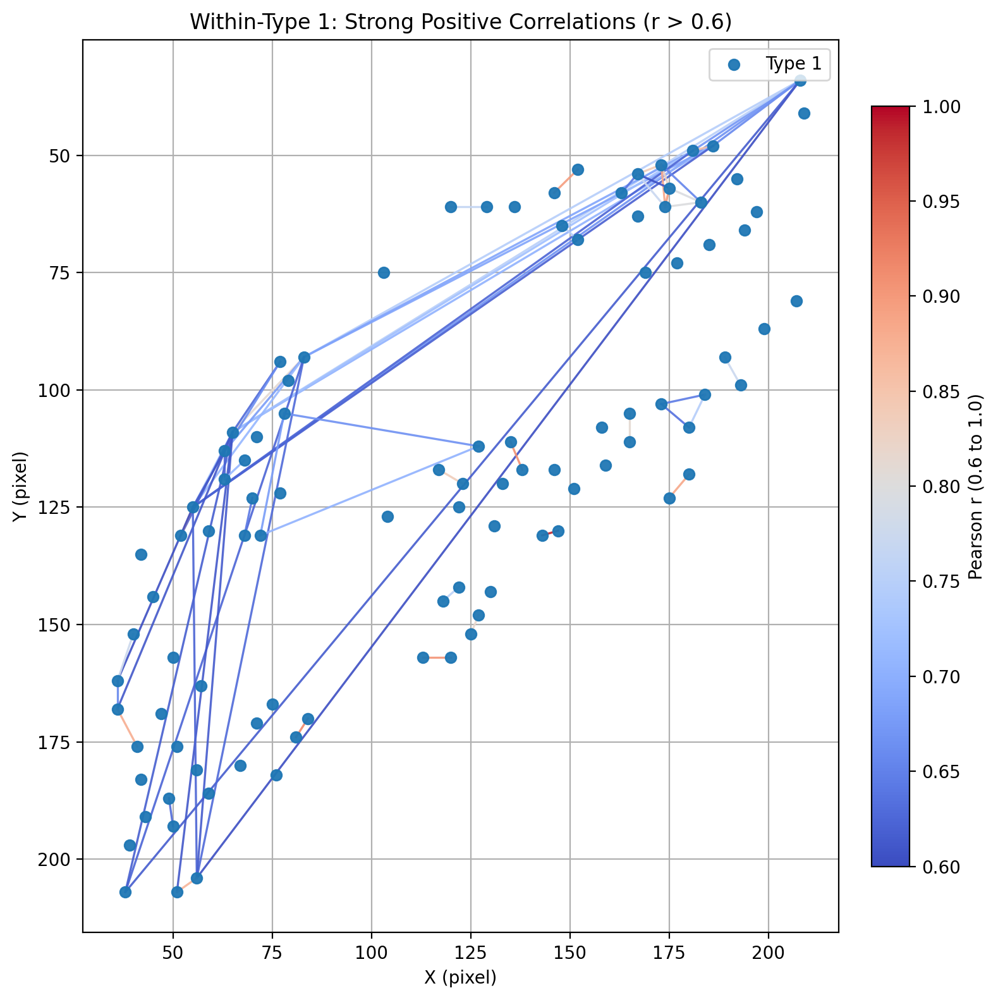

In [24]:
import matplotlib.pyplot as plt
import matplotlib as mpl

# Update color normalization: show only r in 0.6–1.0 range
cmap = plt.cm.coolwarm
norm = mpl.colors.Normalize(vmin=0.6, vmax=1)

# Plot for Type 1
plt.figure(figsize=(8, 8))
for i in range(n1):
    for j in range(i + 1, n1):
        r = corr_type1[i, j]
        if r > 0.6:
            color = cmap(norm(r))
            plt.plot([coords_1[i, 0], coords_1[j, 0]],
                     [coords_1[i, 1], coords_1[j, 1]],
                     color=color, linewidth=1.2, alpha=0.9)

plt.scatter(*coords_1.T, color="tab:blue", label="Type 1", alpha=0.95, zorder=5)
plt.title("Within-Type 1: Strong Positive Correlations (r > 0.6)")
plt.xlabel("X (pixel)")
plt.ylabel("Y (pixel)")
plt.legend()
plt.gca().invert_yaxis()
plt.grid(True)

sm = mpl.cm.ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])
cbar = plt.colorbar(sm, fraction=0.046, pad=0.04)
cbar.set_label("Pearson r (0.6 to 1.0)")

plt.tight_layout()
plt.show()


/tmp/ipykernel_351/813814893.py:29: MatplotlibDeprecationWarning:

Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.



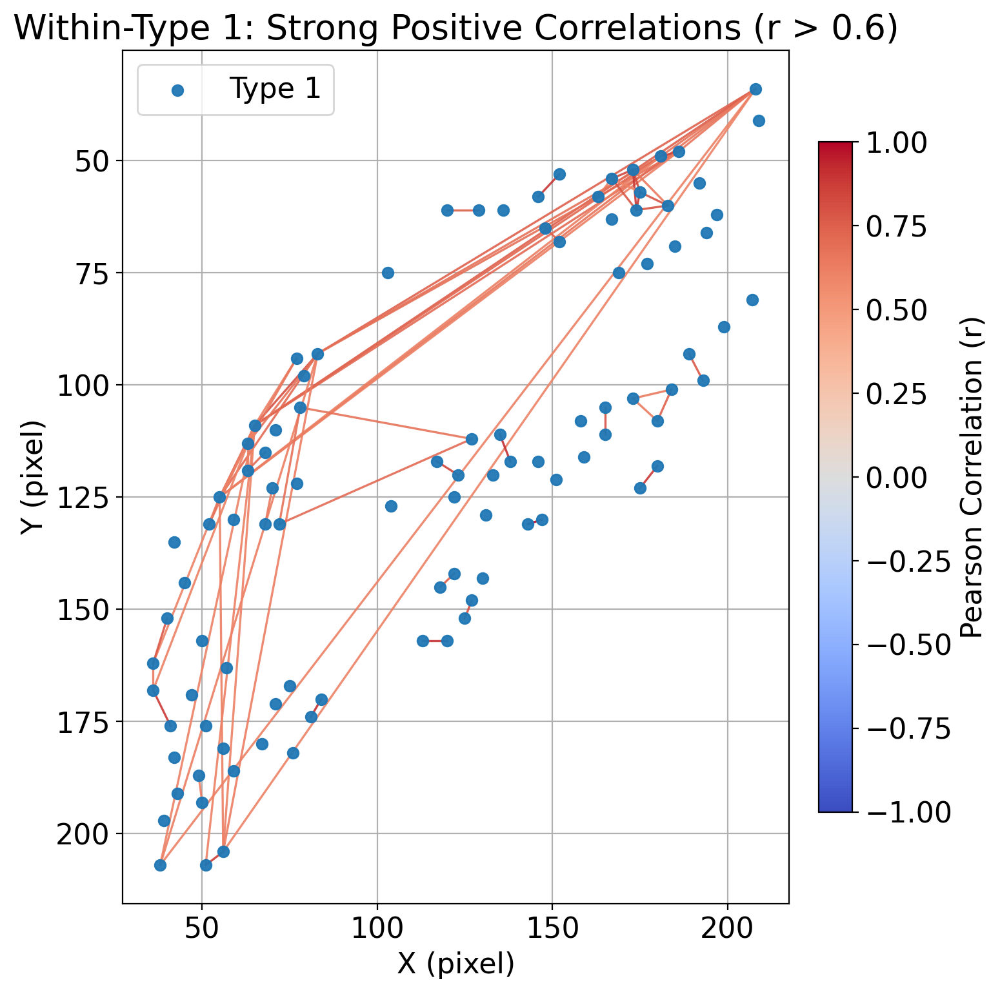

In [25]:
import matplotlib.pyplot as plt
import matplotlib as mpl

# Colormap: full range from -1 to 1
cmap = plt.cm.coolwarm
norm = mpl.colors.Normalize(vmin=-1, vmax=1)

plt.figure(figsize=(8, 8))
for i in range(n1):
    for j in range(i + 1, n1):
        r = corr_type1[i, j]
        if r > 0.6:
            color = cmap(norm(r))
            plt.plot([coords_1[i, 0], coords_1[j, 0]],
                     [coords_1[i, 1], coords_1[j, 1]],
                     color=color, linewidth=1.2, alpha=0.9)

plt.scatter(*coords_1.T, color="tab:blue", label="Type 1", alpha=0.95, zorder=5)
plt.title("Within-Type 1: Strong Positive Correlations (r > 0.6)")
plt.xlabel("X (pixel)")
plt.ylabel("Y (pixel)")
plt.legend()
plt.gca().invert_yaxis()
plt.grid(True)

# Colorbar with full range
sm = mpl.cm.ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])
cbar = plt.colorbar(sm, fraction=0.046, pad=0.04)
cbar.set_label("Pearson Correlation (r)")

plt.tight_layout()
plt.show()


/tmp/ipykernel_351/2386594321.py:22: MatplotlibDeprecationWarning:

Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.



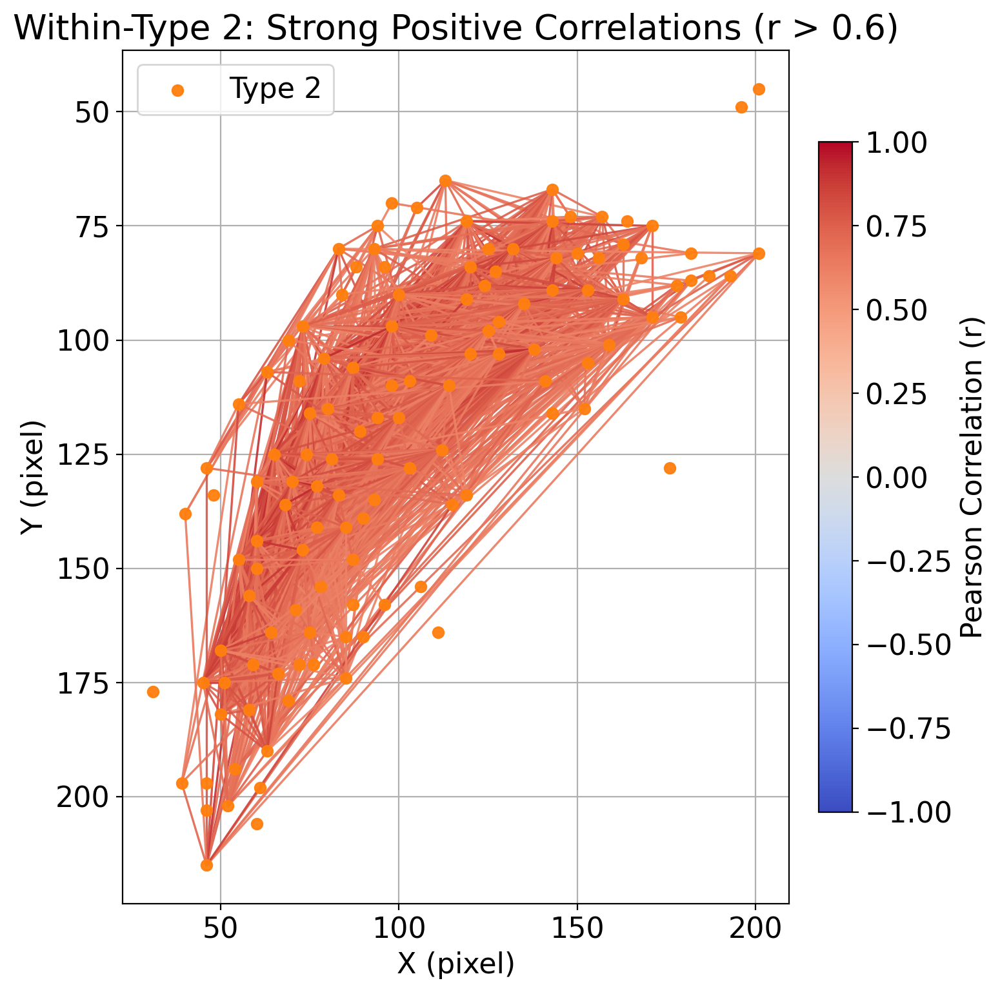

In [26]:
plt.figure(figsize=(8, 8))
for i in range(n2):
    for j in range(i + 1, n2):
        r = corr_type2[i, j]
        if r > 0.6:
            color = cmap(norm(r))
            plt.plot([coords_2[i, 0], coords_2[j, 0]],
                     [coords_2[i, 1], coords_2[j, 1]],
                     color=color, linewidth=1.2, alpha=0.9)

plt.scatter(*coords_2.T, color="tab:orange", label="Type 2", alpha=0.95, zorder=5)
plt.title("Within-Type 2: Strong Positive Correlations (r > 0.6)")
plt.xlabel("X (pixel)")
plt.ylabel("Y (pixel)")
plt.legend()
plt.gca().invert_yaxis()
plt.grid(True)

# Full-range colorbar
sm = mpl.cm.ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])
cbar = plt.colorbar(sm, fraction=0.046, pad=0.04)
cbar.set_label("Pearson Correlation (r)")

plt.tight_layout()
plt.show()


/tmp/ipykernel_351/1426566217.py:40: MatplotlibDeprecationWarning:

Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.



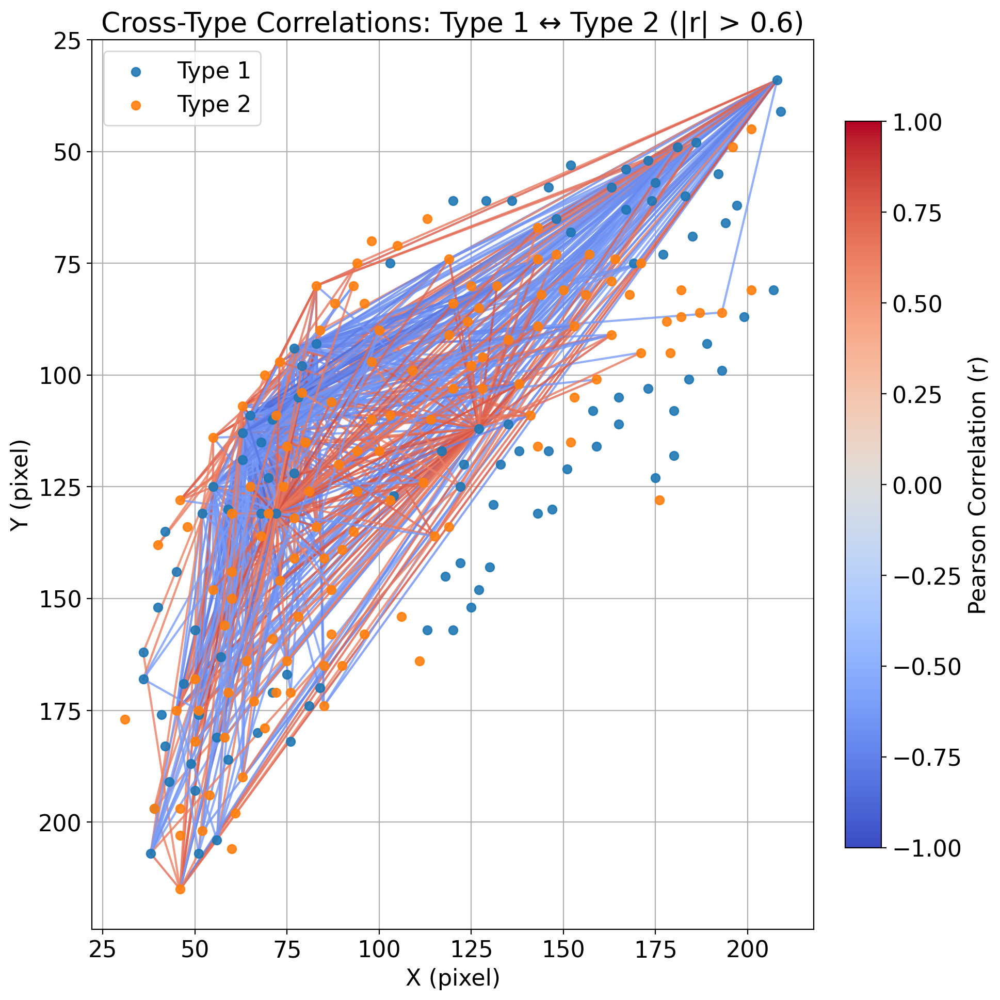

In [27]:
import matplotlib.pyplot as plt
import matplotlib as mpl

# Define thresholds
pos_thresh = 0.6
neg_thresh = -0.6

# Colormap: full correlation range
cmap = plt.cm.coolwarm
norm = mpl.colors.Normalize(vmin=-1, vmax=1)

# Prepare the plot
plt.figure(figsize=(10, 10))

# Scatter both types of ROIs
plt.scatter(*coords_1.T, color="tab:blue", label="Type 1", alpha=0.9, zorder=3)
plt.scatter(*coords_2.T, color="tab:orange", label="Type 2", alpha=0.9, zorder=3)

# Loop through only cross-type pairs
for i in range(n1):
    for j in range(n2):
        r = correlation_matrix[i, n1 + j]  # cross-type correlation
        if r > pos_thresh or r < neg_thresh:
            color = cmap(norm(r))
            plt.plot([coords_1[i, 0], coords_2[j, 0]],
                     [coords_1[i, 1], coords_2[j, 1]],
                     color=color, linewidth=1.5, alpha=0.8)

# Plot settings
plt.title("Cross-Type Correlations: Type 1 ↔ Type 2 (|r| > 0.6)")
plt.xlabel("X (pixel)")
plt.ylabel("Y (pixel)")
plt.legend()
plt.gca().invert_yaxis()
plt.grid(True)

# Add colorbar
sm = mpl.cm.ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])
cbar = plt.colorbar(sm, fraction=0.046, pad=0.04)
cbar.set_label("Pearson Correlation (r)")

plt.tight_layout()
plt.show()


/tmp/ipykernel_351/892058443.py:55: UserWarning:

This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.



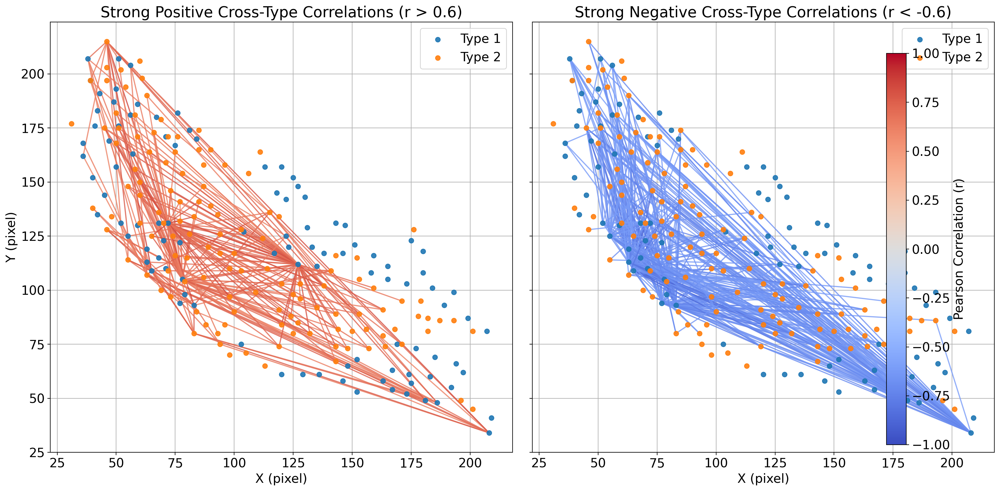

In [28]:
import matplotlib.pyplot as plt
import matplotlib as mpl

# Colormap and normalization
cmap = plt.cm.coolwarm
norm = mpl.colors.Normalize(vmin=-1, vmax=1)

fig, axs = plt.subplots(1, 2, figsize=(18, 9), sharex=True, sharey=True)

# === Plot 1: Positive Correlations ===
axs[0].scatter(*coords_1.T, color="tab:blue", label="Type 1", alpha=0.9, zorder=3)
axs[0].scatter(*coords_2.T, color="tab:orange", label="Type 2", alpha=0.9, zorder=3)

for i in range(n1):
    for j in range(n2):
        r = correlation_matrix[i, n1 + j]
        if r > 0.6:
            color = cmap(norm(r))
            axs[0].plot([coords_1[i, 0], coords_2[j, 0]],
                        [coords_1[i, 1], coords_2[j, 1]],
                        color=color, linewidth=1.5, alpha=0.8)

axs[0].set_title("Strong Positive Cross-Type Correlations (r > 0.6)")
axs[0].set_xlabel("X (pixel)")
axs[0].set_ylabel("Y (pixel)")
axs[0].invert_yaxis()
axs[0].grid(True)
axs[0].legend()

# === Plot 2: Negative Correlations ===
axs[1].scatter(*coords_1.T, color="tab:blue", label="Type 1", alpha=0.9, zorder=3)
axs[1].scatter(*coords_2.T, color="tab:orange", label="Type 2", alpha=0.9, zorder=3)

for i in range(n1):
    for j in range(n2):
        r = correlation_matrix[i, n1 + j]
        if r < -0.6:
            color = cmap(norm(r))
            axs[1].plot([coords_1[i, 0], coords_2[j, 0]],
                        [coords_1[i, 1], coords_2[j, 1]],
                        color=color, linewidth=1.5, alpha=0.8)

axs[1].set_title("Strong Negative Cross-Type Correlations (r < -0.6)")
axs[1].set_xlabel("X (pixel)")
axs[1].invert_yaxis()
axs[1].grid(True)
axs[1].legend()

# === Shared Colorbar ===
sm = mpl.cm.ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])
cbar = fig.colorbar(sm, ax=axs.ravel().tolist(), fraction=0.025, pad=0.02)
cbar.set_label("Pearson Correlation (r)")

plt.tight_layout()
plt.show()


/tmp/ipykernel_351/1815914942.py:58: UserWarning:

The figure layout has changed to tight



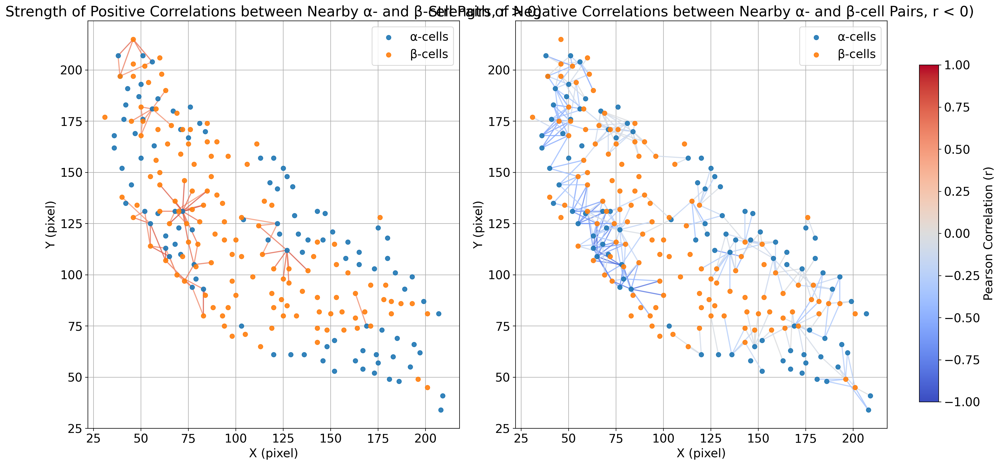

In [30]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl

# Thresholds
pos_thresh = 0.5
neg_thresh = 0
dist_thresh = 20  # pixels (you can adjust this)

# Colormap and normalization
cmap = plt.cm.coolwarm
norm = mpl.colors.Normalize(vmin=-1, vmax=1)

#fig, axs = plt.subplots(1, 2, figsize=(18,9), sharex=True, sharey=True)
fig, axs = plt.subplots(1, 2, figsize=(18, 9), constrained_layout=True)

# === Plot 1: Positive Correlations ===
axs[0].scatter(*coords_1.T, color="tab:blue", label="α-cells", alpha=0.9, zorder=3)
axs[0].scatter(*coords_2.T, color="tab:orange", label="β-cells", alpha=0.9, zorder=3)

for i in range(n1):
    for j in range(n2):
        r = correlation_matrix[i, n1 + j]
        dist = np.linalg.norm(coords_1[i] - coords_2[j])
        if r > pos_thresh and dist < dist_thresh:
            color = cmap(norm(r))
            axs[0].plot([coords_1[i, 0], coords_2[j, 0]],
                        [coords_1[i, 1], coords_2[j, 1]],
                        color=color, linewidth=1.5, alpha=0.8)

axs[0].set_title("Strength of Positive Correlations between Nearby α- and β-cell Pairs, r > 0)")
axs[0].set_xlabel("X (pixel)")
axs[0].set_ylabel("Y (pixel)")
axs[0].grid(True)
axs[0].legend()

# === Plot 2: Negative Correlations ===
axs[1].scatter(*coords_1.T, color="tab:blue", label="α-cells", alpha=0.9, zorder=3)
axs[1].scatter(*coords_2.T, color="tab:orange", label="β-cells", alpha=0.9, zorder=3)

for i in range(n1):
    for j in range(n2):
        r = correlation_matrix[i, n1 + j]
        dist = np.linalg.norm(coords_1[i] - coords_2[j])
        if r < neg_thresh and dist < dist_thresh:
            color = cmap(norm(r))
            axs[1].plot([coords_1[i, 0], coords_2[j, 0]],
                        [coords_1[i, 1], coords_2[j, 1]],
                        color=color, linewidth=1.5, alpha=0.8)

axs[1].set_title("Strength of Negative Correlations between Nearby α- and β-cell Pairs, r < 0)")
axs[1].set_xlabel("X (pixel)")
axs[1].set_ylabel("Y (pixel)")
axs[1].grid(True)
axs[1].legend()

# === Shared Colorbar ===
plt.tight_layout(rect=[0, 0, 0.9, 1])  # Shrink layout first!

cbar_ax = fig.add_axes([0.92, 0.15, 0.02, 0.7])
sm = mpl.cm.ScalarMappable(cmap=cmap, norm=norm)
sm.set_array(np.linspace(-1, 1, 256))
cbar = fig.colorbar(sm, cax=cbar_ax)
cbar.set_label("Pearson Correlation (r)")

plt.show()

/tmp/ipykernel_351/3928656830.py:50: UserWarning:

This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.



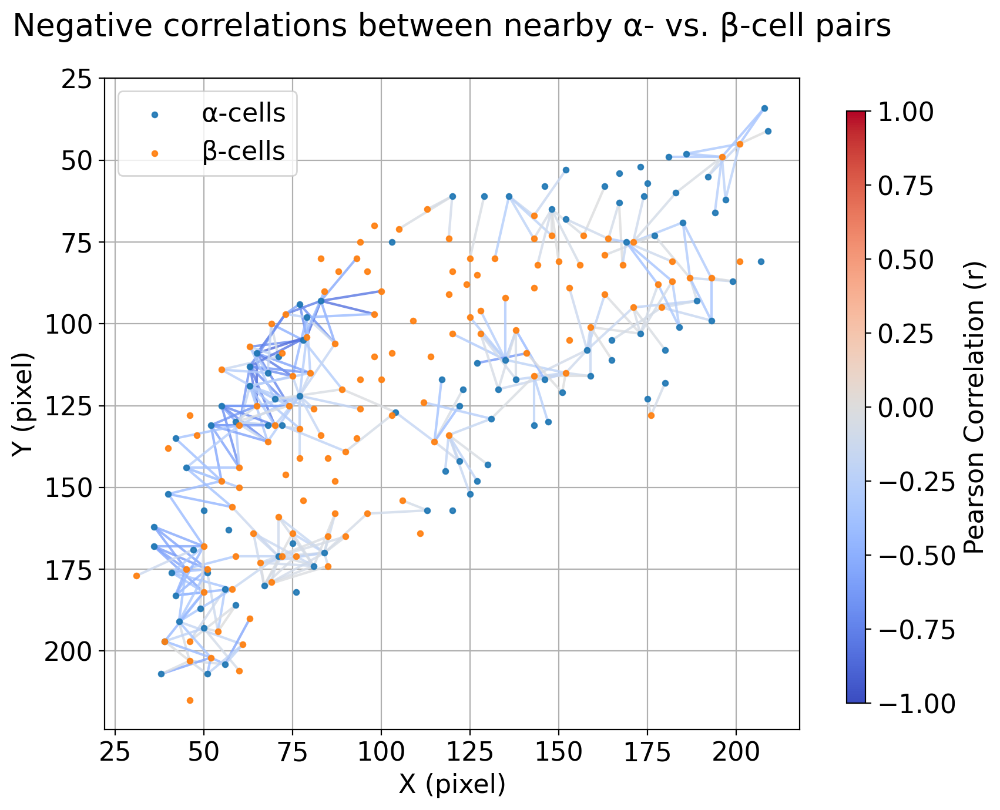

In [36]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl


mpl.rcParams.update({'font.size': 16})

# Thresholds
neg_thresh = 0  # Show correlations r < 0
dist_thresh = 20  # Distance threshold in pixels

# Colormap and normalization
cmap = plt.cm.coolwarm
norm = mpl.colors.Normalize(vmin=-1, vmax=1)

# Create single subplot
fig, ax = plt.subplots(figsize=(8,7.2))

# Plot ROI nodes
ax.scatter(*coords_1.T, color="tab:blue", label="α-cells", alpha=0.9, s=10, zorder=3)
ax.scatter(*coords_2.T, color="tab:orange", label="β-cells", alpha=0.9,s=10, zorder=3)

# Plot correlation lines
for i in range(n1):
    for j in range(n2):
        r = correlation_matrix[i, n1 + j]
        dist = np.linalg.norm(coords_1[i] - coords_2[j])
        if r < neg_thresh and dist < dist_thresh:
            color = cmap(norm(r))
            ax.plot([coords_1[i, 0], coords_2[j, 0]],
                    [coords_1[i, 1], coords_2[j, 1]],
                    color=color, linewidth=1.5, alpha=0.8)

# Plot settings
ax.set_title("Negative correlations between nearby α- vs. β-cell pairs", y=1.05)
ax.set_xlabel("X (pixel)")
ax.set_ylabel("Y (pixel)")
#plt.gca().invert_xaxis()
plt.gca().invert_yaxis()
ax.grid(True)
ax.legend()

# Add colorbar
cbar_ax = fig.add_axes([0.92, 0.15, 0.02, 0.7])
sm = mpl.cm.ScalarMappable(cmap=cmap, norm=norm)
sm.set_array(np.linspace(-1, 1, 256))
cbar = fig.colorbar(sm, cax=cbar_ax)
cbar.set_label("Pearson Correlation (r)")

plt.tight_layout(rect=[0, 0, 0.9, 1])
plt.show()
